#### Problem Description 

<p> Many organizations have found that turnover is a very costly problem. Turnover is a process in which employees leave an organization. Employees leave the company voluntarily or involuntarily. In either way, companies have to replace them. The extent to which employers face turnover rates and the cost often varies by organizations and industries. Depending on the organization or industries, management has to pay particular attention to the turnover rate since it can reduce the productivity and loss of clients that affect the company's long-run bottom line. In this project, we will try to uncover the key variables that contribute to employees' turnover.</p>

####  Import  python libraries

In [1]:

import pandas as pd
from IPython.display import Markdown, display
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns 
import numpy as np
from sklearn import metrics


def printmd(string):
    display(Markdown(string))
       
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

#### Load  the dataset 

In [2]:
# load the dataframe   
df = pd.read_csv('/Users/kouamengoran/desktop/WA_Fn-UseC_-HR-Employee-Attrition.csv')

In [3]:
# Check the shape of the dataset 

In [4]:
df.shape

(1470, 35)

<p> The dataset has  1479  rowa and 35 columns </p>

In [5]:
# check the five first rows of the dataset 
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [6]:
# Display the columns of the dataset 
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

####  Description of  Columns
1. Age (numeric)
2. Attrition ( target variable "yes' for leaving and 'no' for not leaving )
3. BusinessTravel 
4. DailyRate 
5. Department
6. DistanceFromHome
7. Education
8. EducationField
9. EmployeeCount
10. EmployeeNumber
11. EnvironmentSatisfaction
12. Gender
13. HourlyRate'
14. JobInvolvement
15. JobLevel
16. JobRole
17. JobSatisfaction
18. MaritalStatus
19. MonthlyIncome
20. MonthlyRate
21. NumCompaniesWorked
22. Over18
23. OverTime
24. PercentSalaryHike
25. PerformanceRating
26. RelationshipSatisfaction: Relationship Satisfaction is captured as: 1 'Low', 2 'Medium', 3 'High', 4 'Very High'.
27. StandardHours
28. StockOptionLevel
29. TotalWorkingYears
30. TrainingTimesLastYear
31. WorkLifeBalance
32. YearsAtCompany
33. YearsInCurrentRole
34. YearsSinceLastPromotion
35. YearsWithCurrManager

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

#### Data Definition 

In [8]:
#DistanceFromHome ,MonthlyIncome  PercentSalaryHike ,TotalWorkingYears,YearsInCurrentRole,
#YearsSinceLastPromotion,YearsWithCurrManager  

In [9]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [10]:
df.describe(include=['object'])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


In [11]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


**<font color='teal'> We do not have a high cardinality variables. Only the variable  `JobRole` has 9 labels.</font>**

In [12]:
#The recap of the info information  
dtype_df = df.dtypes.reset_index()
dtype_df.columns = ["Count", "Column Type"]
dtype_df.groupby("Column Type").aggregate('count').reset_index()

,Column Type,Count
0,int64,26
1,object,9


In [13]:

df.JobRole.value_counts(normalize=True)

Sales Executive              0.221769
Research Scientist           0.198639
Laboratory Technician        0.176190
Manufacturing Director       0.098639
Healthcare Representative    0.089116
Manager                      0.069388
Sales Representative         0.056463
Research Director            0.054422
Human Resources              0.035374
Name: JobRole, dtype: float64

<p> we have 26  int64 types and 9 object type </p>

In [14]:
#  Chech of missing values 
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<p> No missing value in the dataset </p> 

#### Use pandas  ProfileReport to analyse the  overall analysis of the dataset 

In [15]:
import  pandas_profiling
from pandas_profiling import ProfileReport 
from pandas_profiling.utils.cache import cache_file

In [16]:
profile = ProfileReport(df , title= " My Capstone  project Number 2 ", html ={ "style": {'full_width': True}})
profile

<p> We note that the varaibes MonthlyIncome and Joblevel are higly correlated. JobRole and Department are also hijghly correlated  </p>

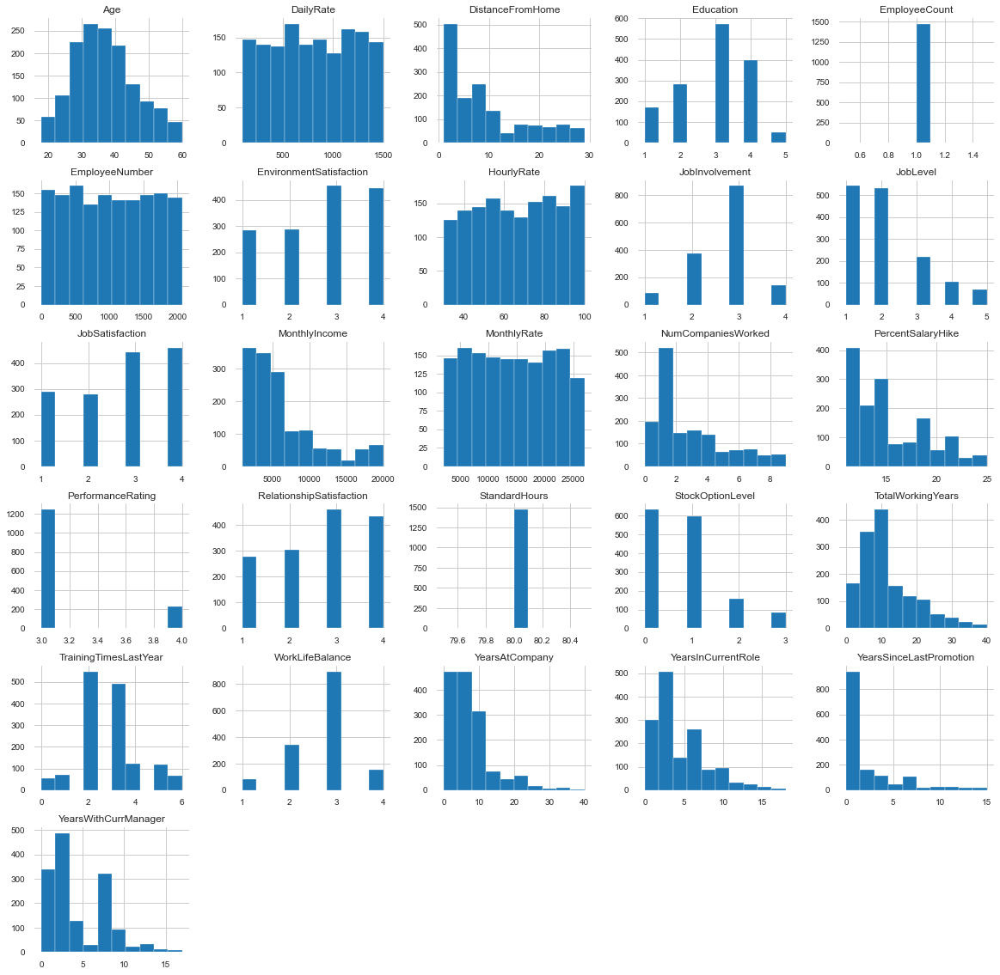

In [17]:
# display the histogram for  numerical variable 
df.hist(figsize=(20,20))
plt.show()


<p> The observation of the histogram shows that, DistanceFromHome, MonthlyIncome,  
NumCompaniesWorked, PercentSalaryHike, TotalWorkingYears ,YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrManager are skewed to the right. We can check the presence of outliers in  for those  vraibale </p>

#### Range of values 

In [18]:
df_range = df.select_dtypes(include=['int64'])
rang = df_range.agg(['min', 'max'])
rang= rang.transpose()
print(rang)

                           min    max
Age                         18     60
DailyRate                  102   1499
DistanceFromHome             1     29
Education                    1      5
EmployeeCount                1      1
EmployeeNumber               1   2068
EnvironmentSatisfaction      1      4
HourlyRate                  30    100
JobInvolvement               1      4
JobLevel                     1      5
JobSatisfaction              1      4
MonthlyIncome             1009  19999
MonthlyRate               2094  26999
NumCompaniesWorked           0      9
PercentSalaryHike           11     25
PerformanceRating            3      4
RelationshipSatisfaction     1      4
StandardHours               80     80
StockOptionLevel             0      3
TotalWorkingYears            0     40
TrainingTimesLastYear        0      6
WorkLifeBalance              1      4
YearsAtCompany               0     40
YearsInCurrentRole           0     18
YearsSinceLastPromotion      0     15
YearsWithCur

#### data cleaning and  visualization 

<p> The dataaet does not have a missing variaable </p> 

In [19]:
# check for duplicate variable 

In [20]:
df["Attrition"] = [0 if x == "Yes" else 1 for x in df["Attrition"]]

In [21]:
# take a look on the response variable 
df['Attrition'].value_counts()/1470


1    0.838776
0    0.161224
Name: Attrition, dtype: float64

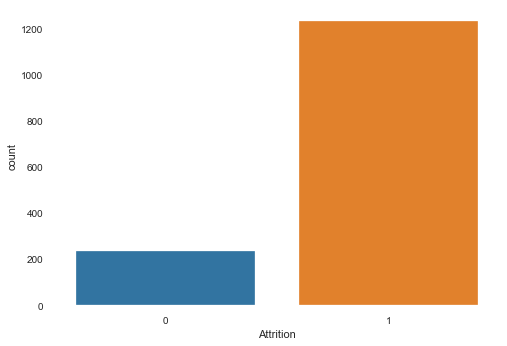

In [22]:
sns.countplot(x='Attrition',data= df)
plt.show()

Text(0.5, 1.0, 'Attrition repatition by Gender')

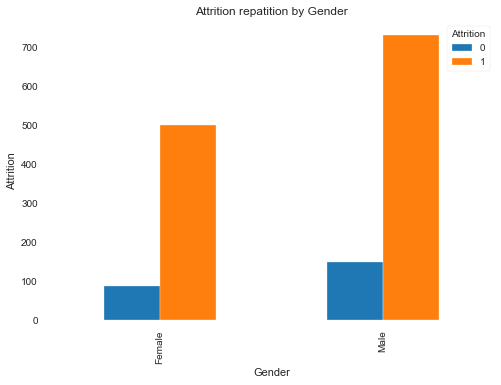

In [23]:
# the repartition of Attrition by gender 
Ct= pd.crosstab(df['Gender'], df['Attrition'])
Ct.plot.bar(stacked=False)
plt.xlabel('Gender')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Gender')

**<font color='teal'> The male's attrition level is greater than women's attrition </font>**

Text(0.5, 1.0, 'Attrition repatition by JobRole')

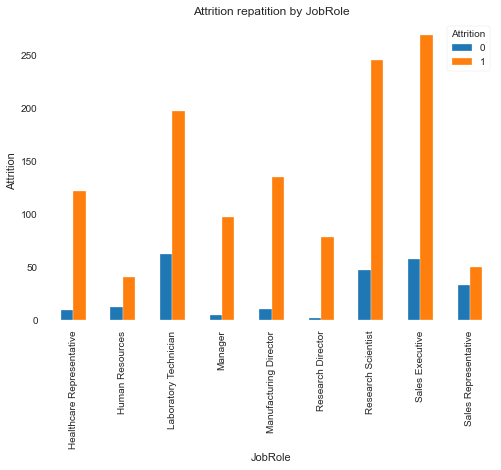

In [24]:
CT= pd.crosstab(df['JobRole'], df['Attrition'])
CT.plot.bar(stacked=False)
plt.xlabel('JobRole')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

Text(0.5, 1.0, 'Attrition repatition by JobRole')

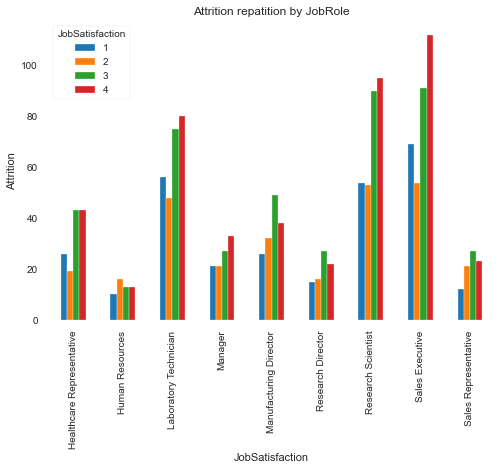

In [25]:
JobS= pd.crosstab(df.JobRole, df.JobSatisfaction)
JobS.plot.bar(stacked=False)
plt.xlabel('JobSatisfaction')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

**<font color='teal'> There are more unsatisfied workers among laboratry technicien and  sales ecexutive</font>**

Text(0.5, 1.0, 'Attrition repatition by BusinessTravel')

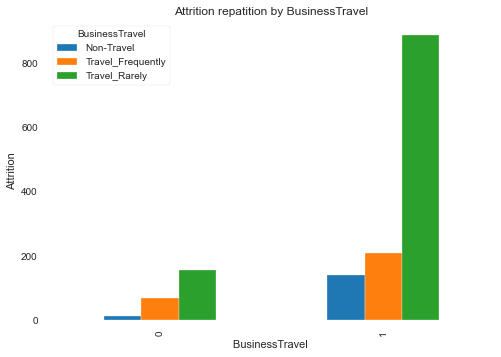

In [26]:
JobTravel= pd.crosstab(df.Attrition, df.BusinessTravel)
JobTravel.plot.bar(stacked=False)
plt.xlabel('BusinessTravel ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by BusinessTravel')

Text(0.5, 1.0, 'Attrition repatition by Department')

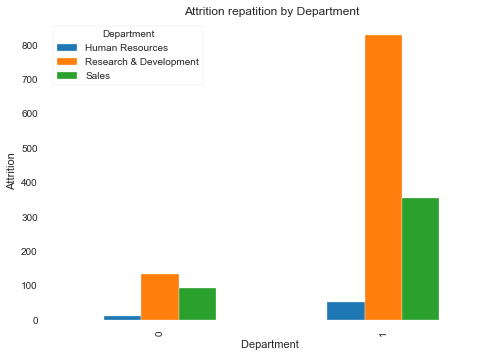

In [27]:
JobTravel= pd.crosstab(df.Attrition, df.Department)
JobTravel.plot.bar(stacked=False)
plt.xlabel('Department ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Department')

#### Check  the outliers 

In [28]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,0,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,1,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,0,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,1,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,1,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [29]:
def diagnostic_plot(dataset, variable):
    
    plt.figure(figsize=(16,4))
    
    #histogram
    plt.subplot(1,3,1)
    sns.distplot(df[variable], bins=30)
    plt.title("Histogram")
    
    # Q-Q plot 
    plt.subplot(1 ,3,2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('RM quantiles')
    
    # boxplot
    plt.subplot(1,3,3)
    sns.boxplot(y= df[variable])
    plt.title(' Boxplot')
    
    plt.show()
    

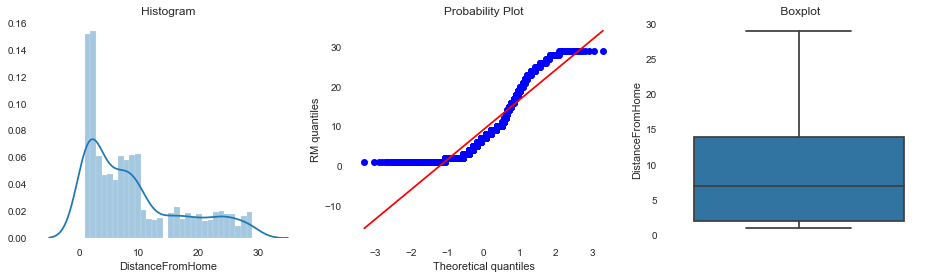

In [30]:
diagnostic_plot(df,'DistanceFromHome')

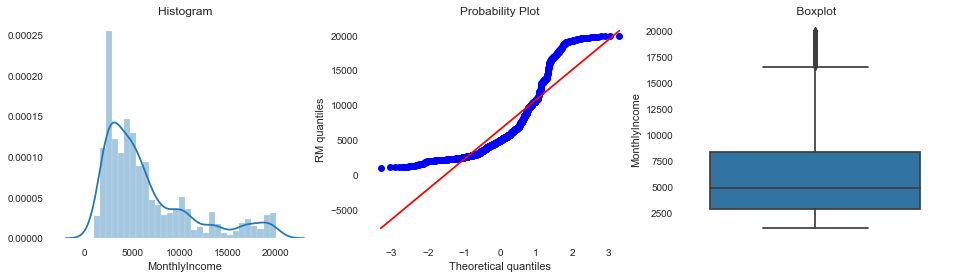

In [31]:
diagnostic_plot(df, 'MonthlyIncome')

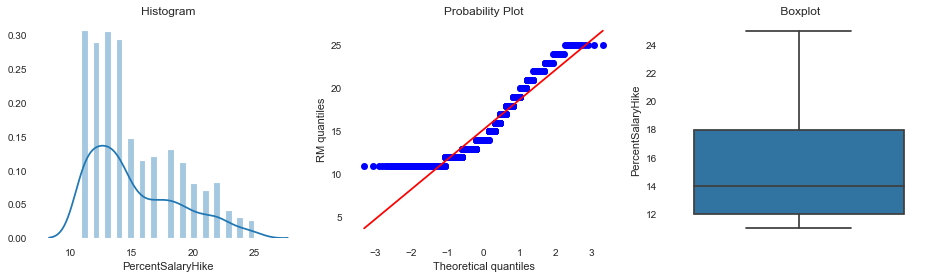

In [32]:
diagnostic_plot(df,'PercentSalaryHike')

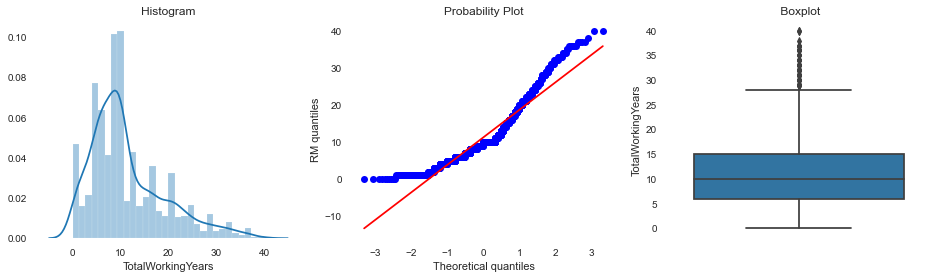

In [33]:
 diagnostic_plot(df,'TotalWorkingYears')

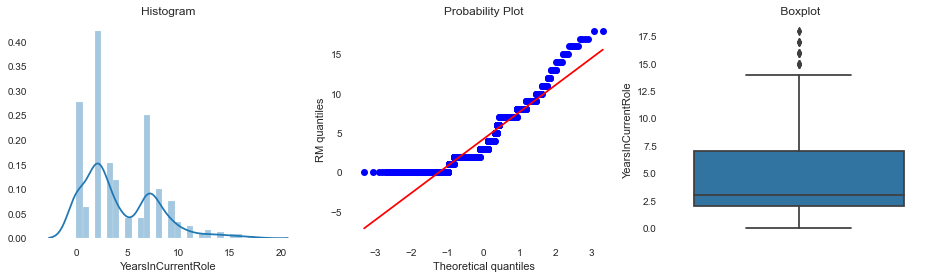

In [34]:
 diagnostic_plot(df,'YearsInCurrentRole' )

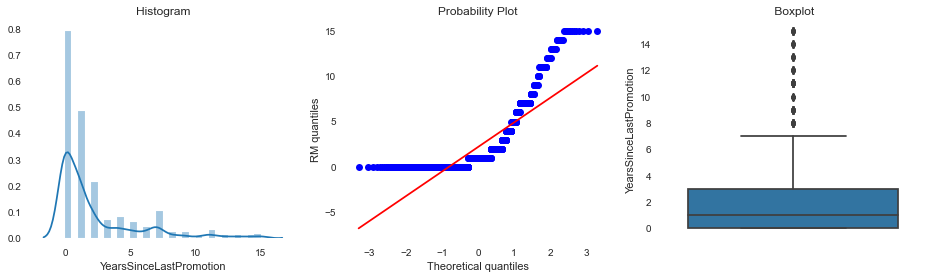

In [35]:
 diagnostic_plot(df, 'YearsSinceLastPromotion' )

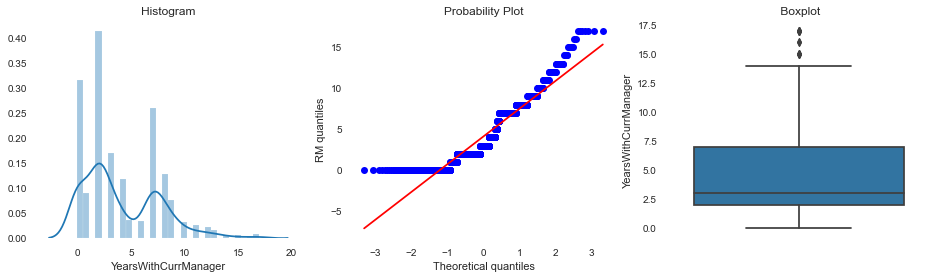

In [36]:
 diagnostic_plot(df, 'YearsWithCurrManager' )

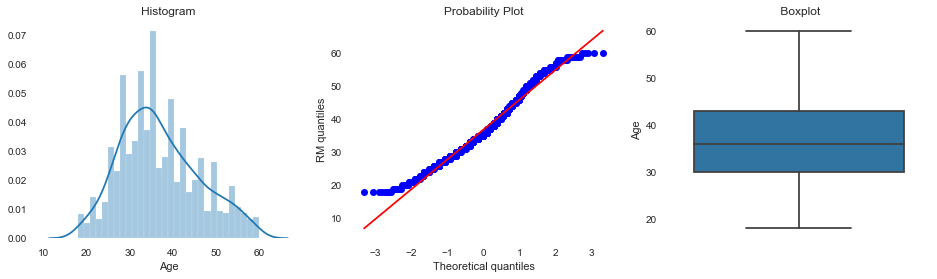

In [37]:
 diagnostic_plot(df, 'Age')

**<font color='teal'> These boxplot show the presence of outliers for the following variable MontlyIcome, YearsIncurrentRole, TotalworkingYears, YearssincelastPromotion , YearsWithcurrManager.</font>**

In [38]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,0,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,1,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,0,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,1,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,1,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


#### Create a dummies variable for the categorical features 

In [39]:
# Create a list categorical features and assign to a list called: todummy_list
todummy_list= ['BusinessTravel','Department','EducationField',
                  'Gender','JobRole','MaritalStatus','Over18','OverTime']

In [40]:
df = pd.concat([df.drop(todummy_list, axis=1), pd.get_dummies(df[todummy_list])], axis=1)

In [41]:
df.shape

(1470, 56)

In [42]:
df.columns

Index(['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction',
       'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StandardHours', 'StockOptionLevel', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager',
       'BusinessTravel_Non-Travel', 'BusinessTravel_Travel_Frequently',
       'BusinessTravel_Travel_Rarely', 'Department_Human Resources',
       'Department_Research & Development', 'Department_Sales',
       'EducationField_Human Resources', 'EducationField_Life Sciences',
       'EducationField_Marketing', 'EducationField_Medical',
       'EducationField_Other', 'EducationField_Technical Degree',
       'Gender_Female', 'Gender

In [43]:
# The reset the index  of the dataframe 
df.reset_index(inplace=True, drop=True)

In [44]:
# Check the first five rows 
df.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,0,1102,1,2,1,1,2,94,3,...,0,0,1,0,0,0,1,1,0,1
1,49,1,279,8,1,1,2,3,61,2,...,0,1,0,0,0,1,0,1,1,0
2,37,0,1373,2,2,1,4,4,92,2,...,0,0,0,0,0,0,1,1,0,1
3,33,1,1392,3,4,1,5,4,56,3,...,0,1,0,0,0,1,0,1,0,1
4,27,1,591,2,1,1,7,1,40,3,...,0,0,0,0,0,1,0,1,1,0


In [45]:
# Remove constant features in the dataframe 

**<font color='teal'> Constant features are the type of features that contain only one value for all the outputs in the dataset. Constant features provide no information that can help in classification of the record at hand. </font>**

In [46]:
Constant_features = [feat for feat in df.columns if df[feat].std()==0]
Constant_features

['EmployeeCount', 'StandardHours', 'Over18_Y']

**<font color='teal'> The value of StandardHours and employeeCount  are respectively   80 and 1 for all the outputs. So we will remove them fron the dataframe </font>**

In [47]:
df.drop ( ['EmployeeCount', 'StandardHours'], axis= 1 , inplace= True )

In [48]:
df.shape

(1470, 54)

#### Find correlated features 

In [49]:
def correlation ( dataset, threshold):
    col_corr= set() # set of all the names of correlated columns 
    corr_matrix = dataset.corr()
    for i in range (len(corr_matrix .columns)):
        for j in range (i):
            if abs( corr_matrix.iloc[i, j]) > threshold: # we are interested in absoluhtes coefficient of correlation 
                colname= corr_matrix .columns [i] # getting the name of column 
                col_corr.add(colname)
    return col_corr

In [50]:
corr_features= correlation (df, 0.8)
len(set(corr_features))

6

In [51]:
corr_features

{'Department_Sales',
 'Gender_Male',
 'JobRole_Human Resources',
 'JobRole_Sales Executive',
 'MonthlyIncome',
 'OverTime_Yes'}

**<font color='teal'> We will remove Department_Sales, JobRole_Human Resources','OverTime_Yes'   feature from the dataset </font>**

In [52]:
# drop correlated features
df.drop(['Department_Sales', 'JobRole_Human Resources','OverTime_Yes'],axis=1,inplace= True )

#### Split the data  into train and test set 

In [53]:

X_train,X_test, y_train, y_test=train_test_split(df.drop(["Attrition"] , axis =1),  df.Attrition, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((1029, 50), (441, 50))

In [54]:
# let's check the variables that share the same information 
from sklearn.feature_selection import mutual_info_classif
from  sklearn.feature_selection import SelectKBest, SelectPercentile 

In [55]:
# Calculate the mutual information between the varaibles and the target 
# this returns  the mutual information value of each  feature
# the smaller the value the less information the feature has about the target
MI = mutual_info_classif( X_train, y_train)
MI

array([0.        , 0.00546754, 0.        , 0.        , 0.        ,
       0.01255374, 0.01509851, 0.        , 0.02500511, 0.01795739,
       0.03146553, 0.01175456, 0.00213481, 0.03015199, 0.        ,
       0.00952405, 0.01693787, 0.01595343, 0.        , 0.        ,
       0.04550234, 0.01850979, 0.0220198 , 0.01128352, 0.01465459,
       0.        , 0.0033861 , 0.00106146, 0.00318824, 0.01361793,
       0.01033298, 0.00490304, 0.00210543, 0.01009693, 0.00235538,
       0.        , 0.00778885, 0.00458189, 0.01332528, 0.        ,
       0.        , 0.0186357 , 0.00369093, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.01492232, 0.02963188])

In [56]:
# let's have a series for clear visualization
MI = pd.Series(MI)
MI.index= X_train.columns
MI.sort_values(ascending=False )

YearsAtCompany                       0.045502
MonthlyIncome                        0.031466
PercentSalaryHike                    0.030152
OverTime_No                          0.029632
JobLevel                             0.025005
YearsSinceLastPromotion              0.022020
JobRole_Research Director            0.018636
YearsInCurrentRole                   0.018510
JobSatisfaction                      0.017957
StockOptionLevel                     0.016938
TotalWorkingYears                    0.015953
HourlyRate                           0.015099
Over18_Y                             0.014922
BusinessTravel_Non-Travel            0.014655
EducationField_Human Resources       0.013618
JobRole_Laboratory Technician        0.013325
EnvironmentSatisfaction              0.012554
MonthlyRate                          0.011755
YearsWithCurrManager                 0.011284
EducationField_Life Sciences         0.010333
EducationField_Other                 0.010097
RelationshipSatisfaction          

 #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target

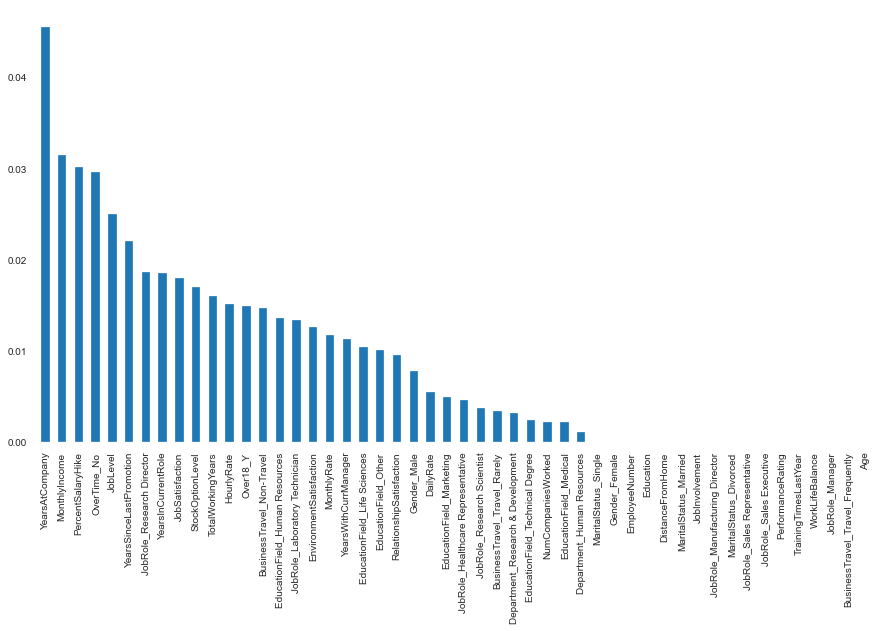

In [57]:
# and now  let's plot  the ordered Mi values per feature
MI.sort_values (ascending=False).plot.bar(figsize= (15, 8))
printmd(" #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target")

In [58]:
# here I will select  the top 20 features 
# which  are shown below 
sel_= SelectKBest(mutual_info_classif, k=30).fit(X_train, y_train)
X_train.columns[sel_.get_support()]

Index(['Age', 'DailyRate', 'Education', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'MonthlyIncome', 'MonthlyRate', 'PerformanceRating',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'BusinessTravel_Travel_Frequently',
       'BusinessTravel_Travel_Rarely', 'Department_Research & Development',
       'EducationField_Human Resources', 'EducationField_Other', 'Gender_Male',
       'JobRole_Laboratory Technician', 'JobRole_Research Scientist',
       'JobRole_Sales Executive', 'JobRole_Sales Representative',
       'MaritalStatus_Married', 'MaritalStatus_Single', 'Over18_Y',
       'OverTime_No'],
      dtype='object')

#### Standardize the magnitude of numeric features

In [59]:
# Here we use the StandardScaler() method of the preprocessing package, and then call the fit() method with parameter X 
scaler = StandardScaler()

In [60]:
# Declare a variable called X_scaled, and assign it the result of calling the transform() method with parameter X 
X_train= scaler.fit_transform(X_train ) 

In [61]:
y=y_train.ravel() 
y

array([1, 0, 1, ..., 1, 1, 1])

In [62]:
y=y_test.ravel()
y

array([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0,
       0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1,

#### Modeling 

#### The first  algorithm is a logistic regression 

In [63]:
# Fit the train  set 
logit = LogisticRegression(random_state=0)
logit.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=0, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [64]:
# Predict the response variable 

In [65]:
y_pred = logit.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[ 39  31]
 [173 198]]


In [66]:
# Classification report 

In [67]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.18      0.56      0.28        70
           1       0.86      0.53      0.66       371

    accuracy                           0.54       441
   macro avg       0.52      0.55      0.47       441
weighted avg       0.76      0.54      0.60       441



In [68]:
# Accuracy Report of the model 

In [69]:
print(' LogReg Accuracy:{}'.format(logit.score(X_test, y_test)))
      

 LogReg Accuracy:0.5374149659863946


In [70]:
# The Roc_auc of  the model 

In [71]:
print('LogReg roc_auc:{}'.format(roc_auc_score(y_test, y_pred)))

LogReg roc_auc:0.5454177897574124


#### The second algorithm is  Support vector machnine  ( SVM)

In [72]:
# Fit the train set 
model =SVC(random_state=0)
model.fit(X_train, y_train)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=0, shrinking=True, tol=0.001,
    verbose=False)

In [73]:
# Predcit the response variable 

y_pred = model.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[  0  70]
 [  0 371]]


In [74]:
# Print the classification report 
print( classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        70
           1       0.84      1.00      0.91       371

    accuracy                           0.84       441
   macro avg       0.42      0.50      0.46       441
weighted avg       0.71      0.84      0.77       441



In [75]:
#The accracy  score of the model  
print('Accuracy of SVC classifier on test set: {:.2f}'.format(model.score(X_test, y_test)))

Accuracy of SVC classifier on test set: 0.84


In [76]:
# The ROC_AUC of the model 
print('model roc_auc:{}'.format(roc_auc_score(y_test, y_pred)))

model roc_auc:0.5


### Adaboost 

In [77]:
# Train the model 
ada= AdaBoostClassifier(n_estimators= 100, random_state=0)
ada.fit (X_train, y_train)

AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None, learning_rate=1.0,
                   n_estimators=100, random_state=0)

In [78]:
# The confusion Matrix 
y_pred = ada.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[  0  70]
 [  0 371]]


In [79]:
# The classification  report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        70
           1       0.84      1.00      0.91       371

    accuracy                           0.84       441
   macro avg       0.42      0.50      0.46       441
weighted avg       0.71      0.84      0.77       441



In [80]:
# the accuracy score 
print(' adaBoost Accuracy:{}'.format(ada.score(X_test, y_test)))
      

 adaBoost Accuracy:0.8412698412698413


In [81]:
#The ROC_AUc of the model 
print('adaBoost roc_auc:{}'.format(roc_auc_score(y_test, y_pred)))

adaBoost roc_auc:0.5


### RandomForest 

In [82]:
# Train the the model
rf = RandomForestClassifier(n_estimators= 100, random_state=0)
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=0, verbose=0,
                       warm_start=False)

In [83]:
# The confusion matrix 
from sklearn.metrics import confusion_matrix
y_pred = rf.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[  1  69]
 [ 13 358]]


In [84]:
# the classification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.07      0.01      0.02        70
           1       0.84      0.96      0.90       371

    accuracy                           0.81       441
   macro avg       0.45      0.49      0.46       441
weighted avg       0.72      0.81      0.76       441



In [85]:
# The accuracy score 
print(' rf Accuracy:{}'.format(rf.score(X_test, y_test)))
      

 rf Accuracy:0.8140589569160998


In [86]:
# The ROC_AUC  of the model  
print(' rf roc_auc:{}'.format(roc_auc_score(y_test, y_pred)))

 rf roc_auc:0.48962264150943396


### conclusion 

**<font color='teal'>I used  four  different machine learing algorithms( Logistic Regression, Support Vecteur Machine (SVM) , AdaBoost, and RandomForest) to predict the the rsponse variable, Atrrition.  I noticed that the ensemble learning algorithms ( Adaboost , RandomForest) are more accurate. Their accuracy scores are respectively 84,12% and 81,40%.   The keys factors that contribute to employees's turnover are: YearsAtCompany, MonthlyIncome,   PercentSalaryHike, YearsSinceLastPromotion, JobRoleResearch, YearsInCurrentRole                JobSatisfaction, StockOptionLevel, and TotalWorkingYears.</font>**